In [1]:
import cv2
from matplotlib import pyplot as plt
import numpy as np

In [2]:
def high_pass_filter(image):
    cv2.imwrite('first_example.jpg',image)
    img = cv2.imread('first_example.jpg',0)
    dft_image = cv2.dft(np.float32(img), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift_image = np.fft.fftshift(dft_image)
    magnitude_image = 20 * np.log((cv2.magnitude(dft_shift_image[:, :, 0], dft_shift_image[:, :, 1]))+1)
    rows, cols = img.shape
    crow, ccol = int(rows / 2), int(cols / 2)
    mask = np.ones((rows, cols, 2), np.uint8)
    r = 200
    center = [crow, ccol]
    x, y = np.ogrid[:rows, :cols]
    mask_area = (x - center[0]) ** 2 + (y - center[1]) ** 2 <= r*r
    mask[mask_area] = 0
    fshift_image = dft_shift_image * mask
    fshift_mask_mag = 20 * np.log(cv2.magnitude(fshift_image[:, :, 0], fshift_image[:, :, 1])+1)
    f_ishift_image = np.fft.ifftshift(fshift_image)
    img_back = cv2.idft(f_ishift_image)
    img_back = cv2.magnitude(img_back[:, :, 0], img_back[:, :, 1])
    fig = plt.figure(figsize=(12, 12))
    ax1 = fig.add_subplot(2,2,1)
    ax1.imshow(img,cmap='gray')
    ax1.title.set_text('Input Image')
    ax2 = fig.add_subplot(2,2,2)
    ax2.imshow(magnitude_image,cmap='gray')
    ax2.title.set_text('FFT of image')
    ax3 = fig.add_subplot(2,2,3)
    ax3.imshow(fshift_mask_mag,cmap='gray')
    ax3.title.set_text('FFT + Mask')
    ax4 = fig.add_subplot(2,2,4)
    ax4.imshow(img_back,cmap='gray')
    ax4.title.set_text('After inverse FFT')
    plt.show()

In [10]:
def low_pass_filter(image):
    cv2.imwrite('first_example.jpg',image)
    img = cv2.imread('first_example.jpg',0)
    dft_image = cv2.dft(np.float32(img), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift_image = np.fft.fftshift(dft_image)
    magnitude_image = 20 * np.log((cv2.magnitude(dft_shift_image[:, :, 0], dft_shift_image[:, :, 1]))+1)
    rows, cols = img.shape
    crow, ccol = int(rows / 2), int(cols / 2)
    mask = np.zeros((rows, cols, 2), np.uint8)
    r = 80
    center = [crow, ccol]
    x, y = np.ogrid[:rows, :cols]
    mask_area = (x - center[0]) ** 2 + (y - center[1]) ** 2 <= r*r
    mask[mask_area] = 1
    fshift_image = dft_shift_image * mask
    fshift_mask_mag = 20 * np.log(cv2.magnitude(fshift_image[:, :, 0], fshift_image[:, :, 1])+1)
    f_ishift_image = np.fft.ifftshift(fshift_image)
    img_back = cv2.idft(f_ishift_image)
    img_back = cv2.magnitude(img_back[:, :, 0], img_back[:, :, 1])
    fig = plt.figure(figsize=(12, 12))
    ax1 = fig.add_subplot(2,2,1)
    ax1.imshow(img,cmap='gray')
    ax1.title.set_text('Input Image')
    ax2 = fig.add_subplot(2,2,2)
    ax2.imshow(magnitude_image,cmap='gray')
    ax2.title.set_text('FFT of image')
    ax3 = fig.add_subplot(2,2,3)
    ax3.imshow(fshift_mask_mag,cmap='gray')
    ax3.title.set_text('FFT + Mask')
    ax4 = fig.add_subplot(2,2,4)
    ax4.imshow(img_back,cmap='gray')
    ax4.title.set_text('After inverse FFT')
    plt.show()

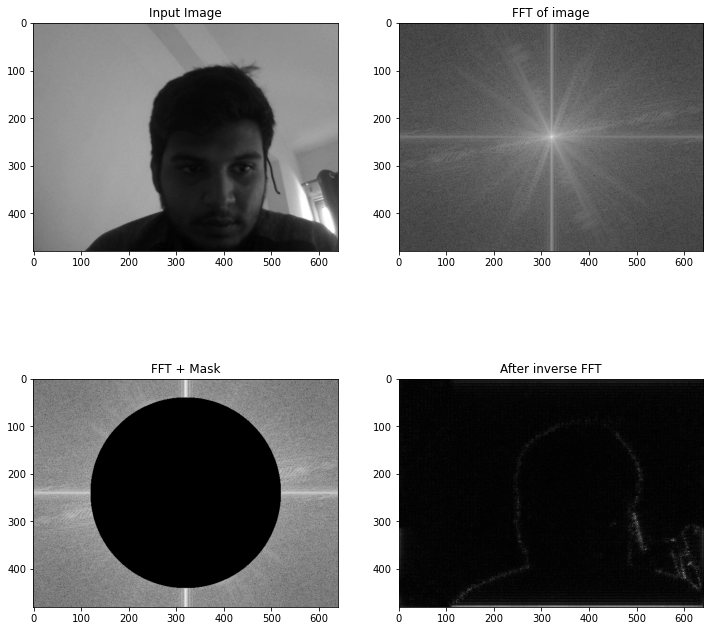

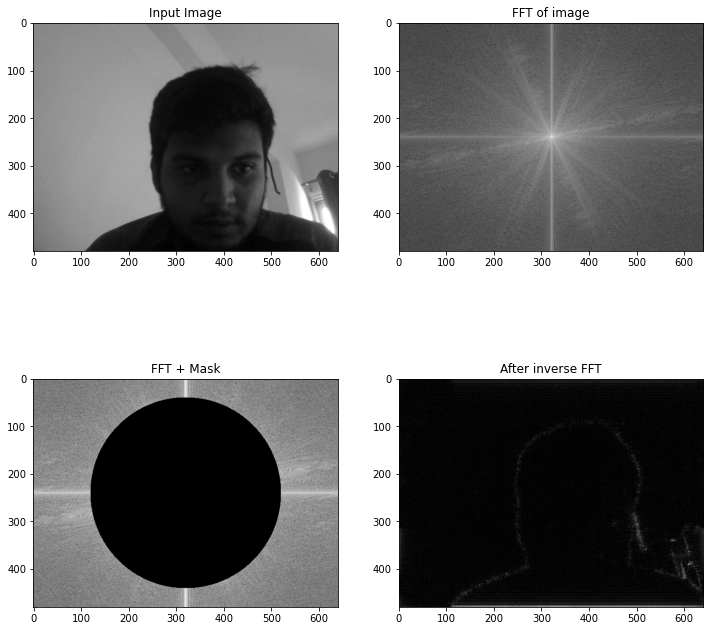

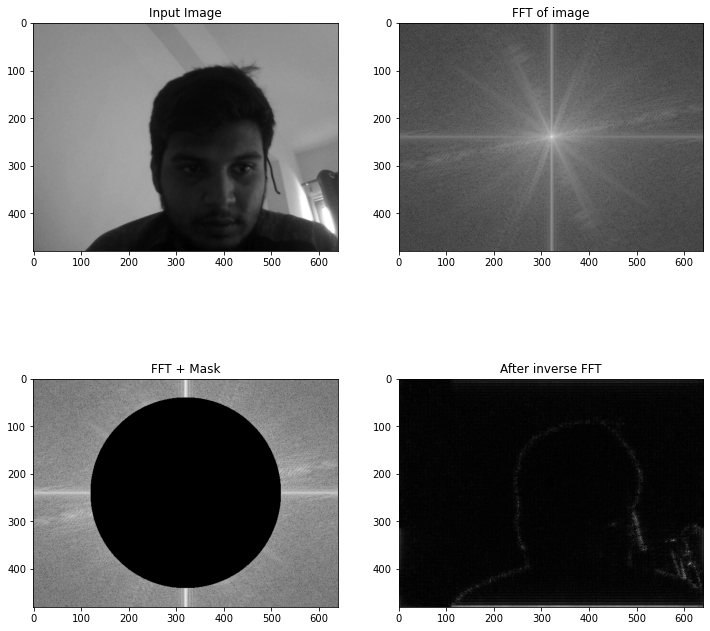

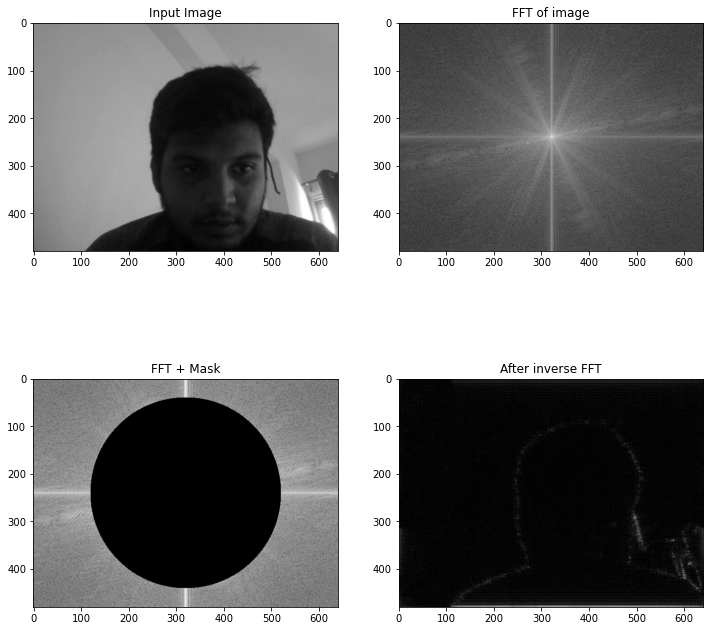

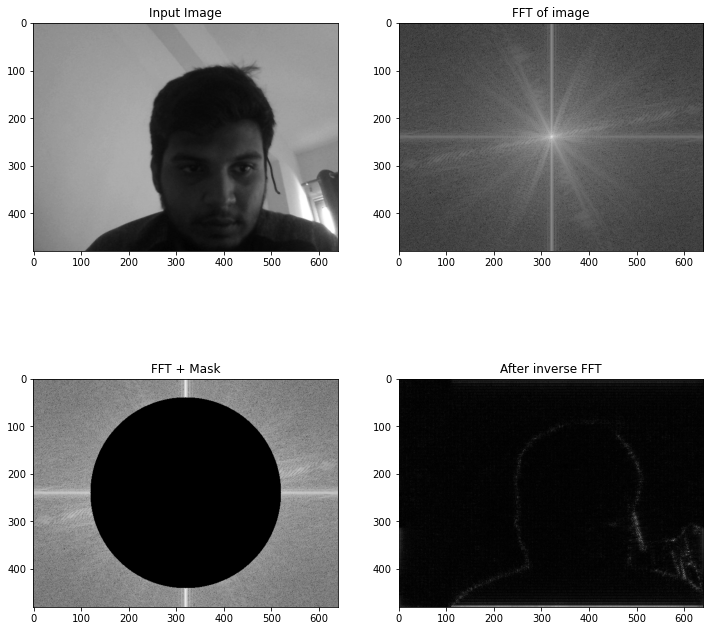

...

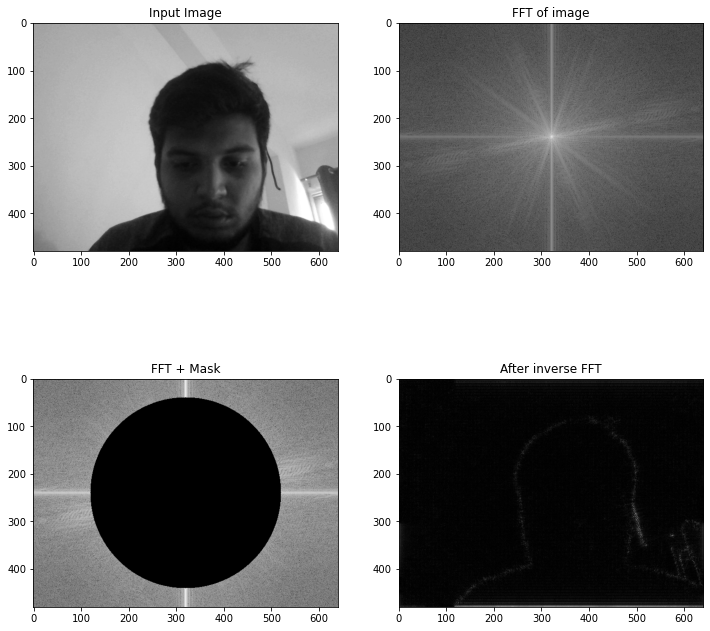

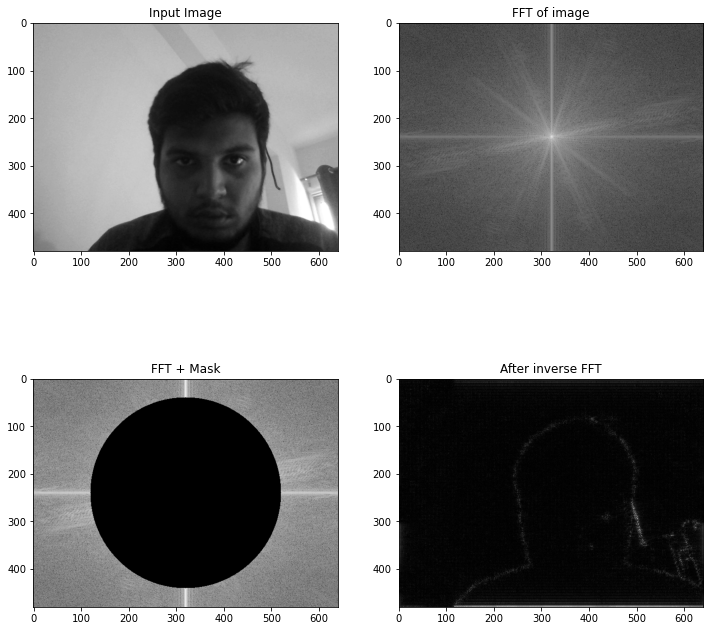

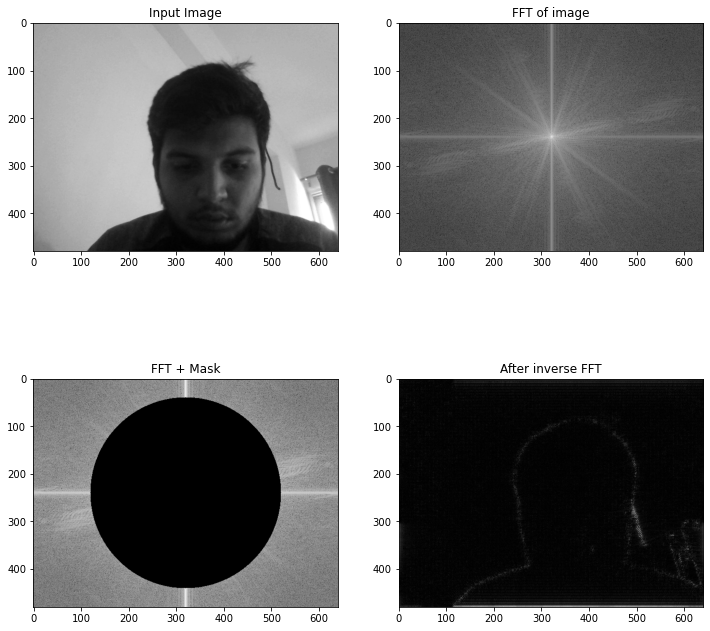

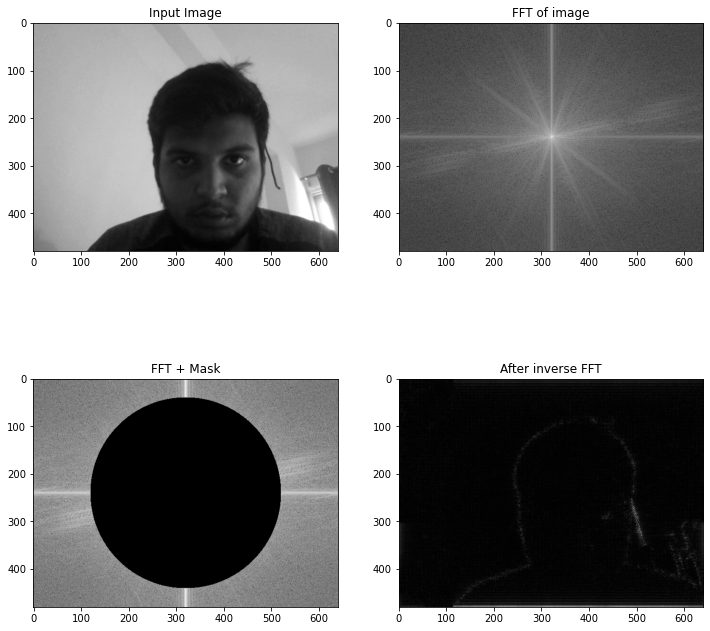

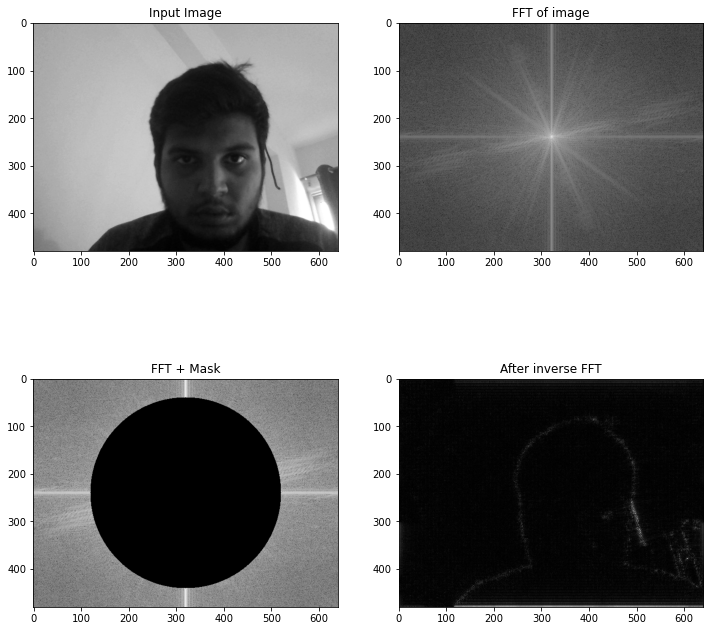

In [4]:
cap=cv2.VideoCapture(0)

while True:
    ret,frame=cap.read()
    if ret==False:
        break
    
    high_pass_filter(frame)
    cv2.imshow('Web_Cam',frame)
    if cv2.waitKey(1)==ord('q'):
        break
cv2.destroyAllWindows()

In [5]:
cap.release()

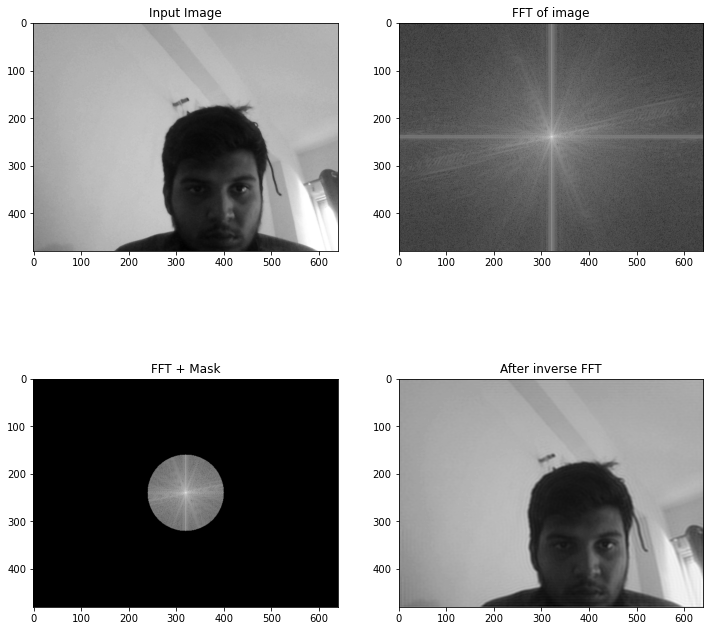

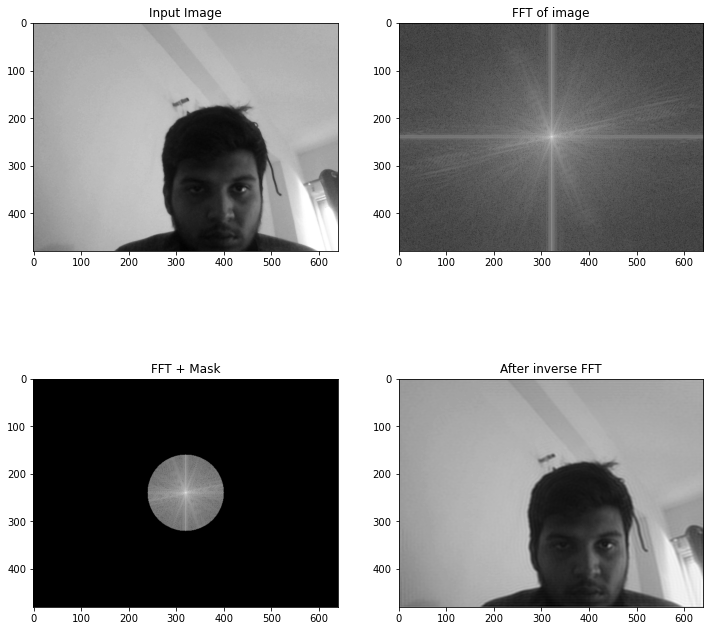

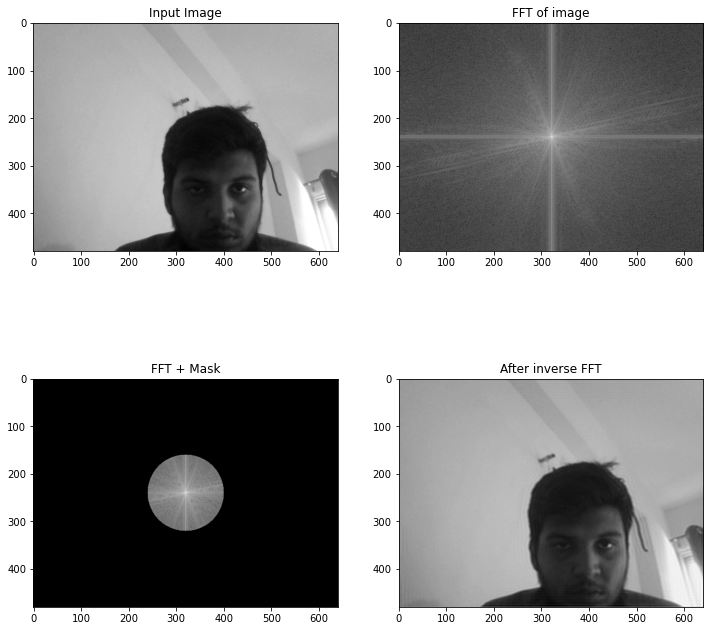

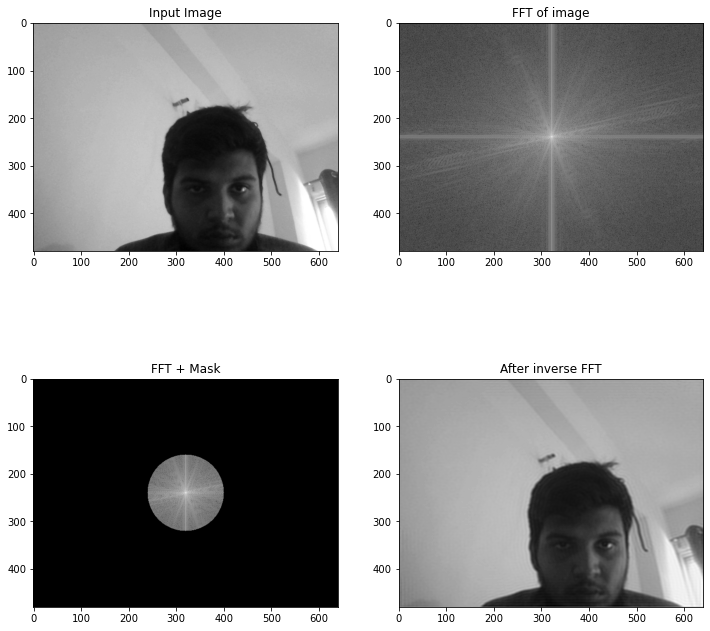

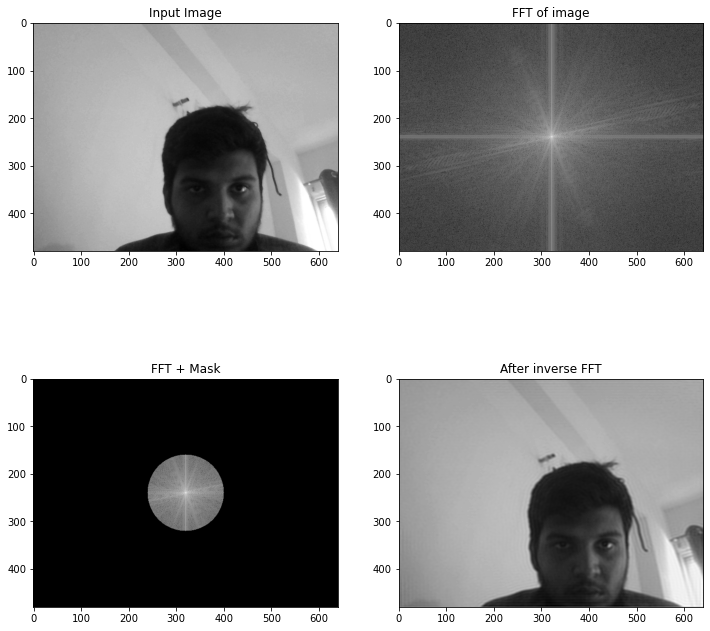

...

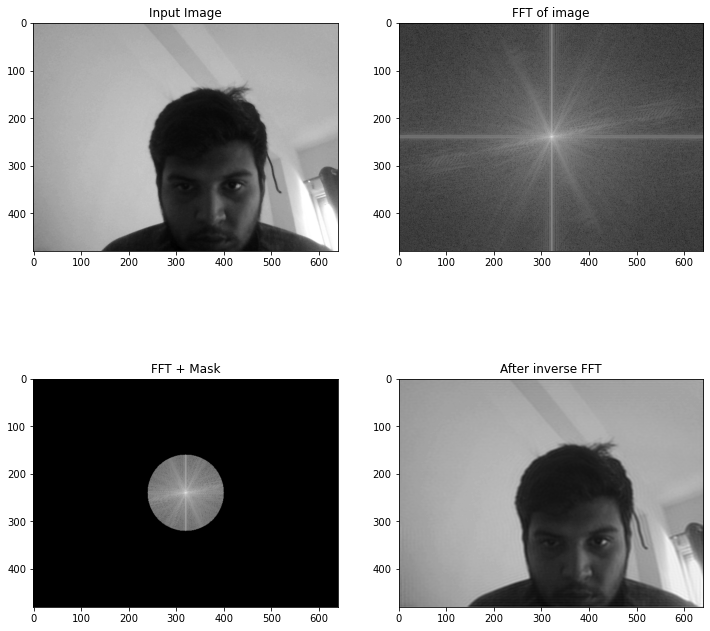

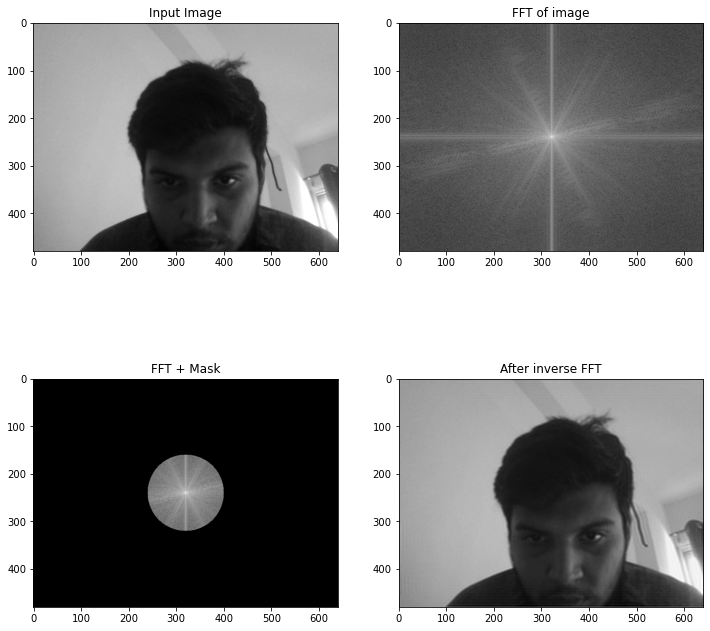

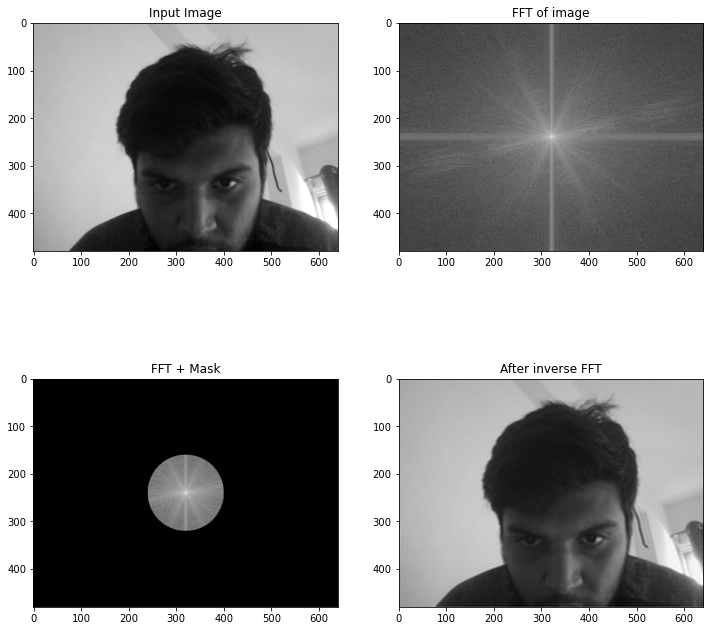

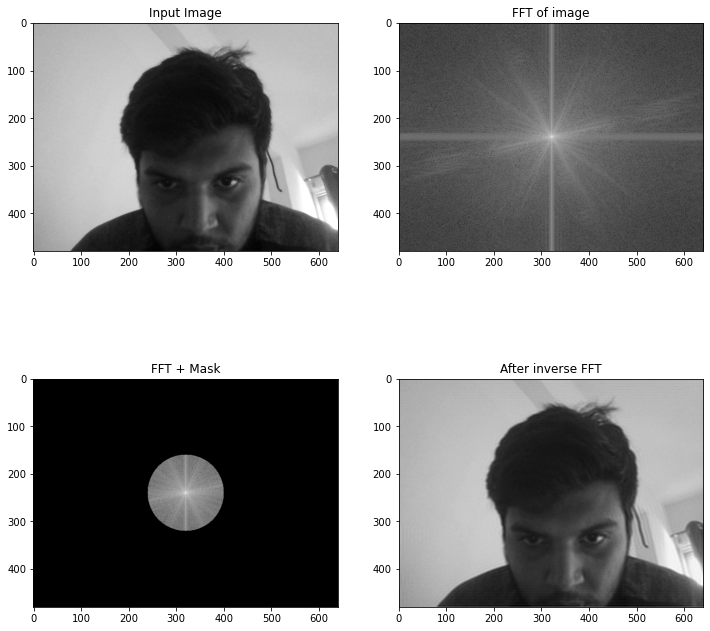

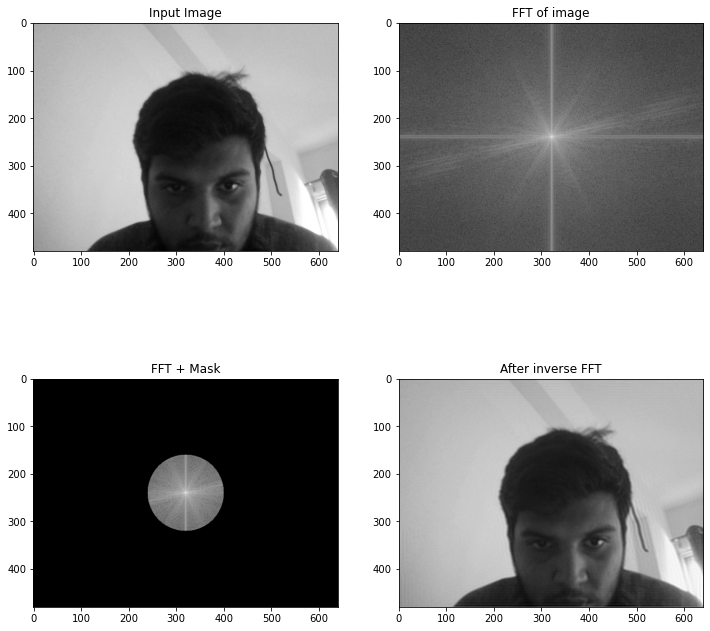

In [12]:
cap=cv2.VideoCapture(0)

while True:
    ret,frame=cap.read()
    if ret==False:
        break
    
    low_pass_filter(frame)
    cv2.imshow('Web_Cam',frame)
    if cv2.waitKey(1)==ord('q'):
        break
cv2.destroyAllWindows()

In [13]:
cap.release()

In [14]:
def band_pass_filter(image):
    cv2.imwrite('first_example.jpg',image)
    img = cv2.imread('first_example.jpg',0)
    dft_image = cv2.dft(np.float32(img), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift_image = np.fft.fftshift(dft_image)
    magnitude_image = 20 * np.log((cv2.magnitude(dft_shift_image[:, :, 0], dft_shift_image[:, :, 1]))+1)
    rows, cols = img.shape
    crow, ccol = int(rows / 2), int(cols / 2)
    mask = np.zeros((rows, cols, 2), np.uint8)
    r_out = 80
    r_in = 10
    center = [crow, ccol]
    x, y = np.ogrid[:rows, :cols]
    mask_area = np.logical_and(((x - center[0]) ** 2 + (y - center[1]) ** 2 >= r_in ** 2),
                           ((x - center[0]) ** 2 + (y - center[1]) ** 2 <= r_out ** 2))
    mask[mask_area] = 1
    fshift_image = dft_shift_image * mask
    fshift_mask_mag = 20 * np.log(cv2.magnitude(fshift_image[:, :, 0], fshift_image[:, :, 1])+1)
    f_ishift_image = np.fft.ifftshift(fshift_image)
    img_back = cv2.idft(f_ishift_image)
    img_back = cv2.magnitude(img_back[:, :, 0], img_back[:, :, 1])
    fig = plt.figure(figsize=(12, 12))
    ax1 = fig.add_subplot(2,2,1)
    ax1.imshow(img,cmap='gray')
    ax1.title.set_text('Input Image')
    ax2 = fig.add_subplot(2,2,2)
    ax2.imshow(magnitude_image,cmap='gray')
    ax2.title.set_text('FFT of image')
    ax3 = fig.add_subplot(2,2,3)
    ax3.imshow(fshift_mask_mag,cmap='gray')
    ax3.title.set_text('FFT + Mask')
    ax4 = fig.add_subplot(2,2,4)
    ax4.imshow(img_back,cmap='gray')
    ax4.title.set_text('After inverse FFT')
    plt.show()

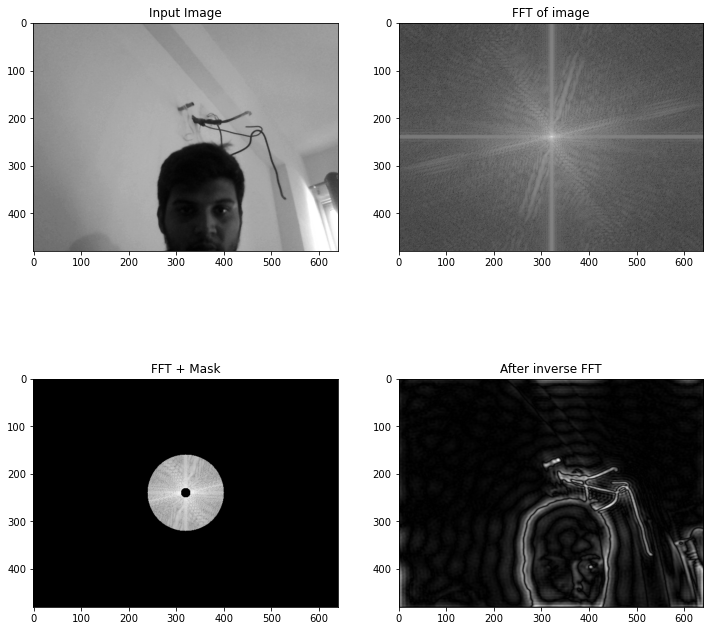

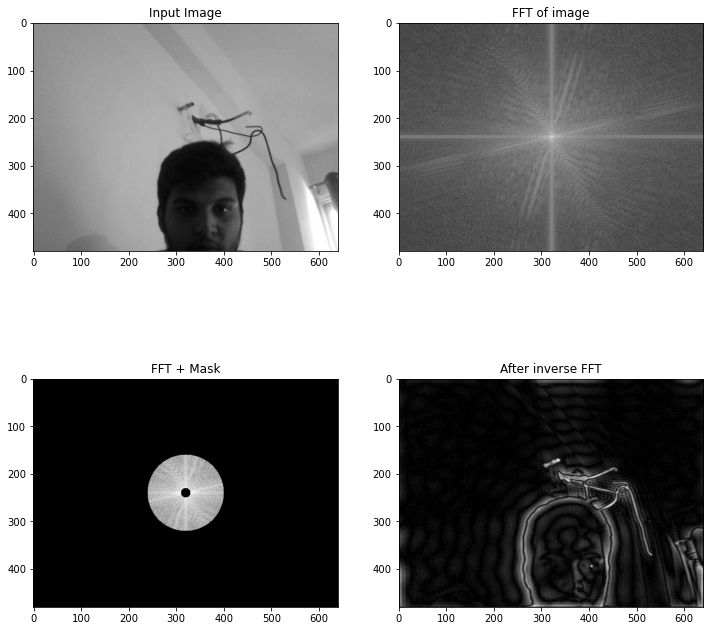

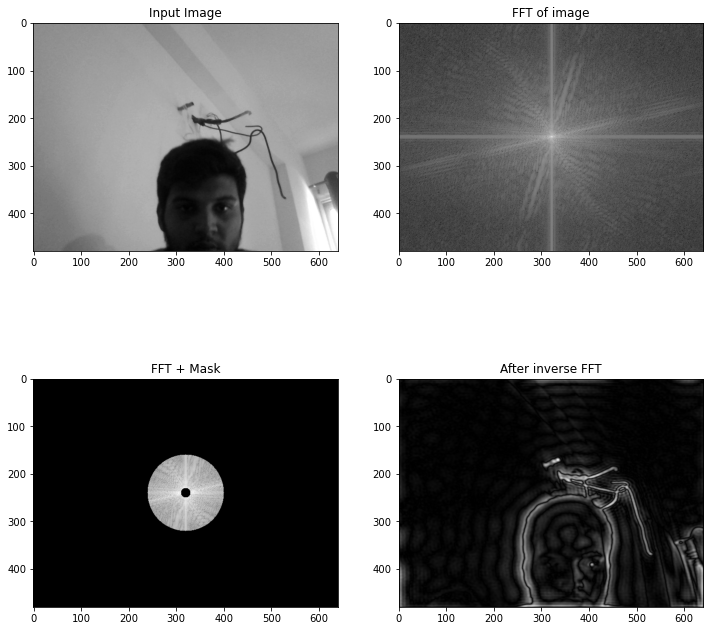

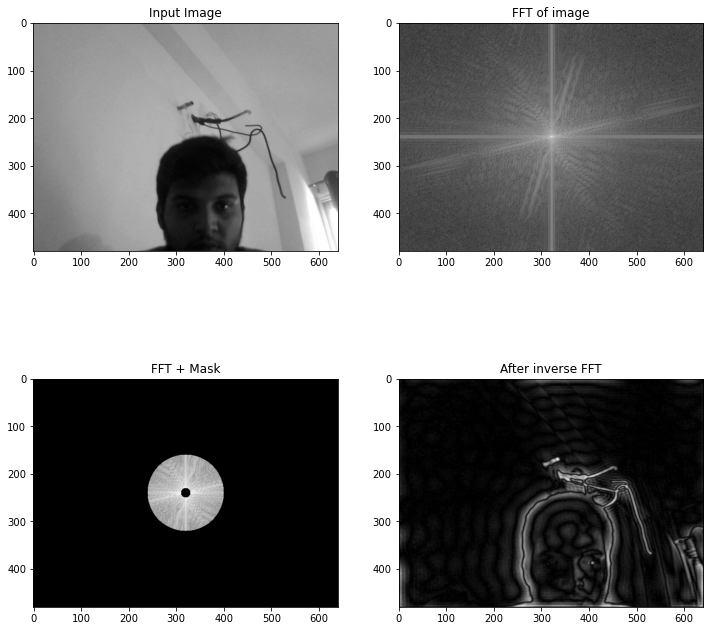

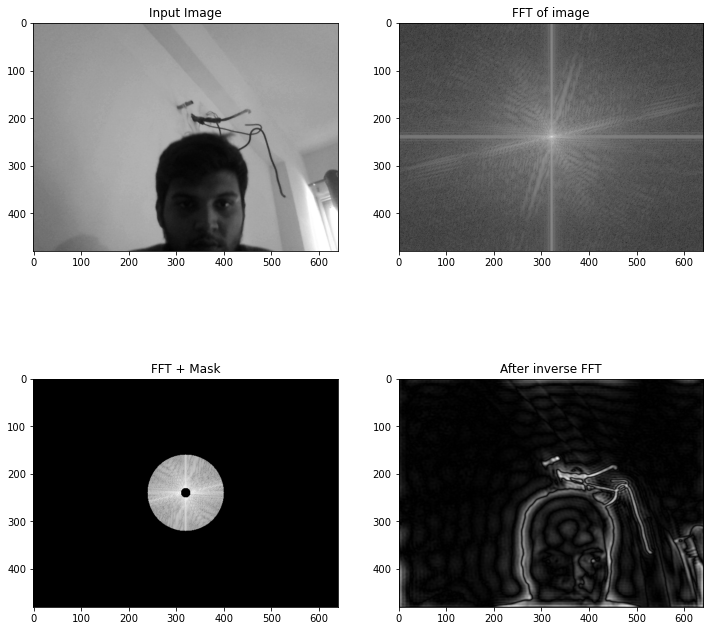

...

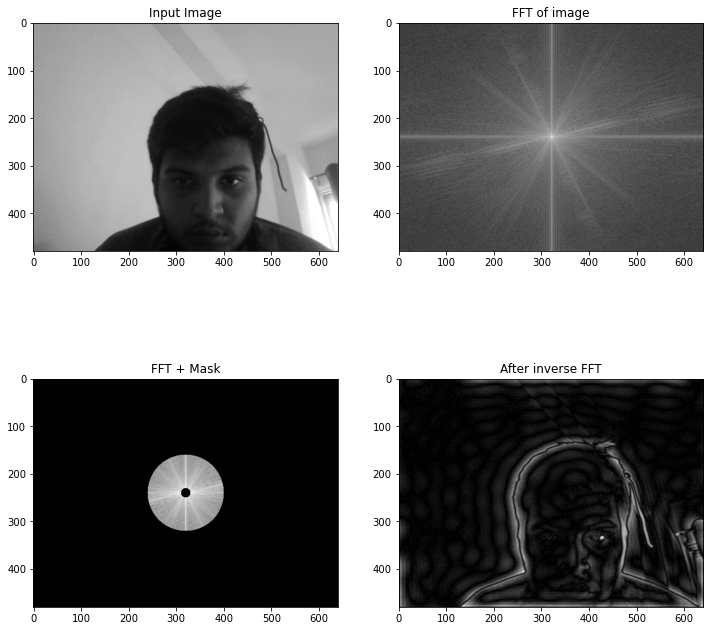

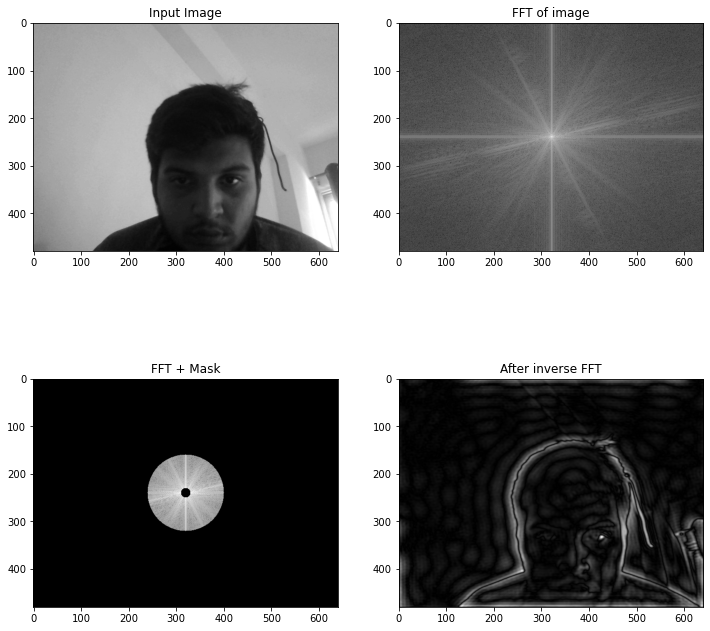

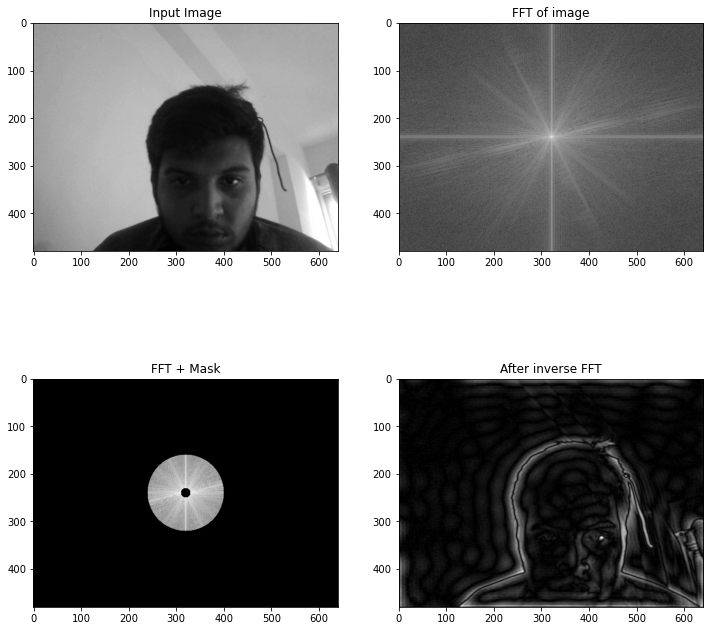

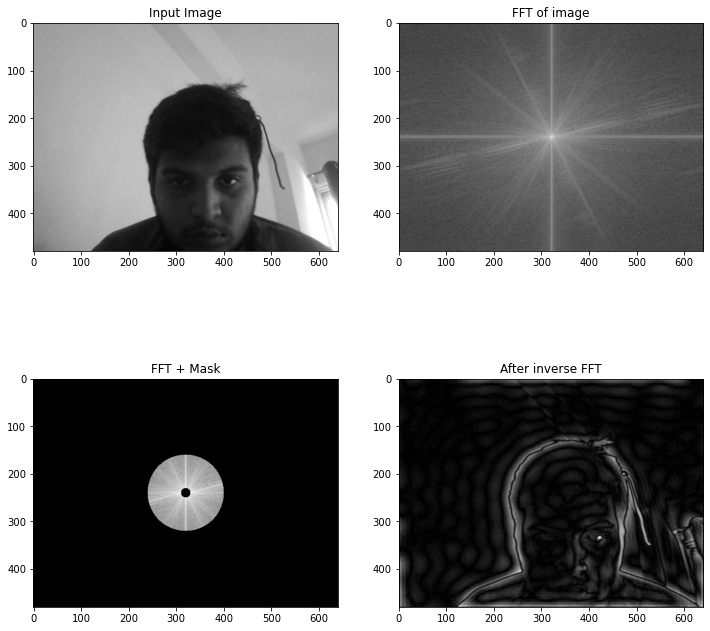

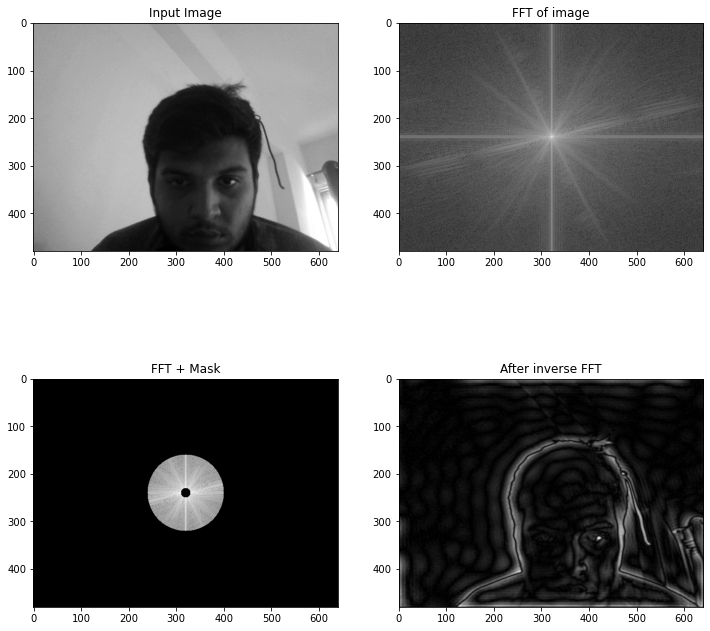

In [15]:
cap=cv2.VideoCapture(0)

while True:
    ret,frame=cap.read()
    if ret==False:
        break
    
    band_pass_filter(frame)
    cv2.imshow('Web_Cam',frame)
    if cv2.waitKey(1)==ord('q'):
        break
cv2.destroyAllWindows()

In [16]:
cap.release()